In [1]:
import os

if "src" not in os.listdir():
    os.chdir("../../../")

import json
from datetime import timedelta
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import pickle

import keras.backend as K
from keras import Model
from keras.layers import Input, LSTM, Dense, Dropout
from keras.optimizers import Adam

%load_ext autoreload
%autoreload 2

from src.lib.stock_dataset import read_stock_dataset
# from src.lib.activations import negative_softmax
from src.lib.losses import negative_profit_loss, multi_negative_sharpe_ratio_loss
from src.lib.util import makedir_to

In [2]:
symbols = ["SPY", "SPXS"]
n_time_steps = 64
n_trades = 15
batch_size = 256
epochs = 5
learning_rate = 0.0003
target_column = "oc_ret"

In [3]:
dataset = read_stock_dataset(symbols, target_column, n_time_steps)
train, valid, test, scaler = dataset.train_valid_test_split(timedelta(days=365), timedelta(days=365), scaled=True)
n_features = train.n_features
n_symbols = train.n_symbols
print(f"Loaded {len(train)} training, {len(valid)}, validation, and {len(test)} testing samples")
print(f"{n_features} features")
print(f"{n_symbols} targets")

Loaded 293168 training, 97921, validation, and 97921 testing samples
26 features
2 targets


In [4]:
def build_lstm():
    input_tensor = Input((n_time_steps, n_features))
    z = input_tensor
    lstm_out = LSTM(64)(z)

    z = Dropout(0.25)(lstm_out)
    z = Dense(64, activation="selu")(z)
    z = Dropout(0.1)(z)
    holdings = Dense(n_symbols, activation="softmax", name="holdings")(z)
    
    # z = Dropout(0.25)(lstm_out)
    # z = Dense(64, activation="selu")(z)
    # z = Dropout(0.1)(z)
    # p_invest = Dense(1, activation="sigmoid", name="p_invest")(z)

    # return Model([input_tensor, target_tensor], [holdings, p_invest])
    return Model(input_tensor, holdings)



def backtest_loss(starting_cash=100000, sigmoid_slope=8, risk_free_rate=1e-6):
    def loss(y_true, y_pred): # y_true=(batch_size, n_trades, n_symbols, 2) y_pred=(batch_size, n_trades, n_symbols)
        holdings = K.variable(np.zeros((batch_size, n_symbols))) # (batch_size, n_symbols)
        
        cash = K.variable(np.ones((batch_size,)) * starting_cash) # (batch_size,)
        sim_equity = K.variable(np.zeros(batch_size, n_trades)) # (batch_size, n_trades)
        for i in range(n_trades):
            trade_index = i+n_time_steps

            pred = y_pred[:, i] # (batch_size, n_symbols)
            
            avg_price = K.mean(y_true[:, trade_index-1, :, :], -1) # (batch_size, n_symbols)
            this_equity = cash + avg_price * holdings # (batch_size, n_symbols)
            
            sim_equity[:, i] = this_equity # Can I do this?
            
            bid = y_true[:, trade_index-1, :, 0] # (batch_size, n_symbols)
            ask = y_true[:, trade_index-1, :, 1] # (batch_size, n_symbols))

            p_hold = holdings * avg_price / sim_equity[:, i] # (batch_size, n_symbols)
            p_hold_delta = pred - p_hold # (batch_size, n_symbols)
            share_delta = p_hold_delta * sim_equity[:, i] / avg_price # (batch_size, n_symbols)

            # trade_price = ask if share_delta > 0 else bid

            s = K.sigmoid(sigmoid_slope*p_hold_delta) # (batch_size, n_symbols)
            trade_price = ask * s + bid * (1-s) # (batch_size, n_symbols)
            trade_cost = p_hold_delta * trade_price # (batch_size, n_symbols)

            holdings += share_delta # (batch_size, n_symbols)
            cash -= K.sum(trade_cost, -1) # (batch_size,)
            
        # sim_equity (batch_size, n_trade)
        ret = K.mean((sim_equity[:, 1:] - sim_equity[:, :-1]) / sim_equity[:, :-1], -1) # (batch_size,)
        std = K.std(sim_equity, -1) # (batch_size,)

        sharpe = (ret - risk_free_rate) / (std + K.epsilon()) # (batch_size,)
        return -sharpe
    return loss

def build_model():
    target_tensor = Input((n_trades, n_symbols, 2)) # (batch_size, n_trades, n_symbols, 2)
    input_tensor = Input((n_time_steps + n_trades - 1, n_features)) # (batch_size, n_time_steps + n_trades -1, n_features)
    
    lstm = build_lstm()

    preds = []
    for i in range(n_trades):
        trade_index = i+n_time_steps
        lstm_input = input_tensor[:, i:trade_index] # (batch_size, n_time_steps, n_features)
        preds.append(lstm(lstm_input)) # (batch_size, n_symbols)

    preds = K.concatenate(preds, 0) # (n_trades, batch_size, n_symbols)
    preds = preds.transpose((1, 0, 2)) # (batch_size, n_trades, n_symbols)

    model = Model([input_tensor, target_tensor], preds)

    model.compile(Adam(learning_rate=learning_rate), loss=backtest_loss())

    return model, lstm

    # holdings = K.variable(np.zeros((batch_size, n_symbols))) # (batch_size, n_symbols)
    
    # cash = K.variable(np.ones((batch_size,)) * starting_cash) # (batch_size,)
    # sim_equity = K.variable(np.zeros(batch_size, n_trades)) # (batch_size, n_trades)
    # for i in range(n_trades):
    #     trade_index = i+n_time_steps
    #     lstm_input = input_tensor[:, i:trade_index] # (batch_size, n_time_steps, n_features)
    #     pred = lstm(lstm_input) # (batch_size, n_symbols)
    #     # for j in range(symbols):
    #     #     bid = target_tensor[:, trade_index-1, j, 0] # (batch_size,)
    #     #     ask = target_tensor[:, trade_index-1, j, 1] # (batch_size,)
    #     #     avg = (bid + ask)/2 # (batch_size,)
    #     #     this_equity += avg * holdings[:, j] # (batch_size,)
        
    #     avg_price = K.mean(target_tensor[:, trade_index-1, :, :], -1) # (batch_size, n_symbols)
    #     this_equity = cash + avg_price * holdings # (batch_size, n_symbols)
        
    #     sim_equity[:, i] = this_equity # Can I do this?

    #     # for j, symbol in enumerate(symbols):
    #     #     bid = target_tensor[:, trade_index-1, j, 0] # (batch_size,)
    #     #     ask = target_tensor[:, trade_index-1, j, 1] # (batch_size,)
    #     #     avg = avg_price[:, j] # (batch_size,)

    #     #     p_hold = holdings[:, j] * avg / sim_equity[:, i] # (batch_size,)

    #     #     p_hold_delta = pred[:, j] - p_hold # (batch_size,)

    #     #     share_delta = p_hold_delta * sim_equity[:, i] / avg # (batch_size,)

    #     #     # trade_price = ask if share_delta > 0 else bid

    #     #     s = K.sigmoid(8*p_hold_delta) # (batch_size,)
    #     #     trade_price = ask * s + bid * (1-s) # (batch_size,)

    #     #     trade_cost = p_hold_delta * trade_price # (batch_size,)

    #     #     cash -= trade_cost # (batch_size,)
    #     #     holdings[:, j] += share_delta # (batch_size,)
        
    #     bid = target_tensor[:, trade_index-1, :, 0] # (batch_size, n_symbols)
    #     ask = target_tensor[:, trade_index-1, :, 1] # (batch_size, n_symbols))

    #     p_hold = holdings * avg_price / sim_equity[:, i] # (batch_size, n_symbols)

    #     p_hold_delta = pred - p_hold # (batch_size, n_symbols)

    #     share_delta = p_hold_delta * sim_equity[:, i] / avg_price # (batch_size, n_symbols)

    #     # trade_price = ask if share_delta > 0 else bid

    #     s = K.sigmoid(sigmoid_slope*p_hold_delta) # (batch_size, n_symbols)
    #     trade_price = ask * s + bid * (1-s) # (batch_size, n_symbols)

    #     trade_cost = p_hold_delta * trade_price # (batch_size, n_symbols)

    #     holdings += share_delta # (batch_size, n_symbols)
    #     cash -= K.sum(trade_cost, -1) # (batch_size,)
        
    # # sim_equity (batch_size, n_trade)
    # ret = K.mean((sim_equity[:, 1:] - sim_equity[:, :-1]) / sim_equity[:, :-1], -1) # (batch_size,)
    # std = K.std(sim_equity, -1) # (batch_size,)

    # sharpe = (ret - risk_free_rate) / (std + K.epsilon()) # (batch_size,)



In [5]:
train_batchable_index = train.get_batchable_index(trade_market_open=True)
n_iter_per_epoch = len(train_batchable_index)//batch_size

loss_history = []

model, pred_model = build_model()
# valid_batchable_index = valid.get_batchable_index(trade_market_open=True)
# X_batch_valid, y_batch_valid = valid.get_batch(len(valid_batchable_index), valid_batchable_index, replace=False, shuffle=False)

for epoch in range(epochs):
    pbar = tqdm(range(n_iter_per_epoch))
    for i in pbar:
        # y_true=(batch_size, n_trades, n_symbols, 2)
        X_batch, y_batch = train.get_batch(batch_size, train_batchable_index)
        loss = model.train_on_batch([X_batch, y_batch])
        loss_history.append(loss)

        if len(loss_history) > 150:
            avg_loss = np.mean(loss_history[-150:])
        else:
            avg_loss = np.mean(loss_history)
        
        pbar.set_description("sharpe=%.3f" % -avg_loss)
    
    
    # losses_valid = model.evaluate([X_batch_valid, y_batch_valid])
    # avg_loss_valid = np.mean(losses_valid)


    # print("Valid Sharpe:", -avg_loss_valid)

  0%|          | 0/1144 [00:00<?, ?it/s]2021-09-24 11:02:25.040382: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2021-09-24 11:02:25.042222: W tensorflow/core/platform/profile_utils/cpu_utils.cc:126] Failed to get CPU frequency: 0 Hz
sharpe=-0.052: 100%|██████████| 1144/1144 [00:35<00:00, 32.06it/s]


3059/3059 [==============================] - 4s 1ms/step - loss: 0.2398
Valid Sharpe: -0.2397591471672058


sharpe=-0.054: 100%|██████████| 1144/1144 [00:35<00:00, 31.95it/s]


3059/3059 [==============================] - 4s 1ms/step - loss: -0.0592
Valid Sharpe: 0.0592152439057827


sharpe=-0.046: 100%|██████████| 1144/1144 [00:35<00:00, 32.01it/s]


3059/3059 [==============================] - 4s 1ms/step - loss: 0.2361
Valid Sharpe: -0.23614516854286194


sharpe=-0.052: 100%|██████████| 1144/1144 [00:35<00:00, 32.34it/s]


3059/3059 [==============================] - 4s 1ms/step - loss: -0.0324
Valid Sharpe: 0.03240674361586571


sharpe=-0.065: 100%|██████████| 1144/1144 [00:36<00:00, 31.09it/s]


3059/3059 [==============================] - 4s 1ms/step - loss: 0.2149
Valid Sharpe: -0.2149316966533661


SPY


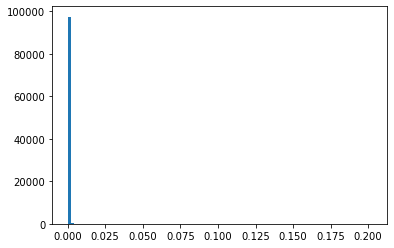

SPXS


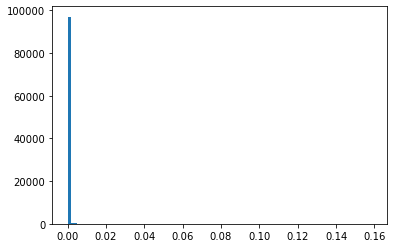

Allocation


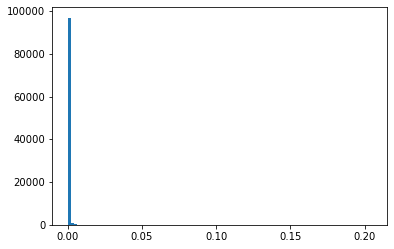

In [6]:
preds = pred_model.predict(X_batch_valid)
for i, symbol in enumerate(symbols):
    print(symbol)
    plt.hist(preds[:, i], bins=100)
    plt.show()

print("Allocation")
plt.hist(np.abs(preds).sum(-1), bins=100)
plt.show()

In [7]:
x = preds[:, 0]
y = preds[:, 1]

heatmap, xedges, yedges = np.histogram2d(x, y, bins=256)
heatmap = np.log(heatmap+1)
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
fig = go.Figure()
fig.add_trace(go.Heatmap(z=heatmap.T))
fig.show()

In [8]:
rets = np.exp((np.log(preds*y_batch_valid + 1)).sum(axis=-1).cumsum())
p_change = rets[::390][1:]/rets[::390][:-1]
print(p_change.mean())
print(p_change.std())
# rets = preds * y_batch_valid
fig = go.Figure()
fig.add_trace(go.Scatter(x=valid.index, y=rets))
fig.show()

0.9999805685582005
0.00010312508134980367


In [9]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=valid.index, y=preds[:, 0], name=symbols[0]))
fig.add_trace(go.Scatter(x=valid.index, y=preds[:, 1], name=symbols[1]))
fig.show()

In [10]:
# name = "4_lstm_long"

# config = {
#     "name": name,
#     "symbols": symbols,
#     "n_time_steps": n_time_steps,
#     "batch_size": batch_size,
#     "epochs": epochs,
#     "learning_rate": learning_rate,
#     "target_column": target_column
# }

# path = os.path.join("results", name)
# makedir_to(os.path.join(path, "file.doesnotexist"))

# with open(os.path.join(path, "config.json"), "w") as f:
#     json.dump(config, f)

# with open(os.path.join(path, "scaler.pkl"), "wb") as f:
#     pickle.dump(scaler, f)

# pred_model.compile()
# pred_model.save(os.path.join(path, "model.h5"))